In [5]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm import tqdm
import pandas as pd
import skimage.io as io
import skimage.transform as trs
import skimage.color as sColor
import math
from sklearn.cluster import KMeans

In [2]:
images = io.imread_collection("../annunc/*.jpg")


In [ ]:
#NON WORKING
theta=[]
r = []
for img in tqdm(images) :
    hsv = sColor.convert_colorspace(img, 'RGB','HSV')
    angSin = 0.0
    angCos = 0.0
    hues =hsv[:,:,0]
    for elem in np.ndarray.flatten(hues):
        angSin += math.sin(elem)
        angCos += math.cos(elem)
    theta.append(math.degrees(math.atan2(angSin/len(hues), angCos/len(hues))))
    r.append(np.mean(np.ndarray.flatten(hsv[:,:,2])))

In [ ]:
#WORKING BUT WEIRD
theta=[]
r = []
for img in tqdm(images) :
    hsv = sColor.convert_colorspace(img, 'RGB','HSV')
    hues =hsv[:,:,0]
    theta.append(np.mean(np.ndarray.flatten(hues)))
    r.append(np.mean(np.ndarray.flatten(hsv[:,:,2])))

In [ ]:
from matplotlib.offsetbox import AnnotationBbox,OffsetImage

fig = plt.figure(figsize = (170,170))
ax = plt.subplot(111, projection='polar')
ax.scatter(theta, r, marker = '.')
for i in range(len(images)) :
    im = OffsetImage(images[i], cmap = 'gray', zoom=1)
    im.image.axis =ax
    ab =AnnotationBbox(im,(theta[i],r[i]),frameon=False) 
    ax.add_artist(ab)
ax.set_rmax(np.max(r))
ax.set_rticks([]) 
ax.grid(True)
plt.show()

In [ ]:
fig.savefig("potround5.jpg")

In [65]:
hsv = sColor.rgb2hsv(images[20])

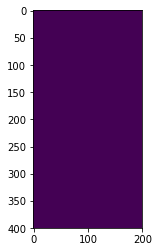

In [66]:
plt.imshow(hsv[:,:,0])

In [67]:
hues= hsv[:,:,0].flatten()

In [68]:
hues.shape



(80000,)

In [69]:
hues = hues.reshape((hues.shape[0],1))

In [71]:
list(filter(lambda x: x!=0,hues))

[]

In [57]:
kmeans = KMeans(n_clusters=3)

In [58]:
kmeans.fit(hues)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [59]:
kmeans.cluster_centers_

array([[ 0.05276512],
       [ 0.9439194 ],
       [ 0.69900514]])

In [60]:
len(list(filter(lambda x : x == 0 ,kmeans.labels_)))

53959

In [61]:
new = kmeans.predict(hues)
new.shape

(80000,)

In [62]:
new = new.reshape((400,200))

In [63]:
new

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ..., 
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

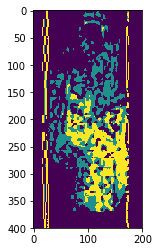

In [64]:
plt.imshow(new)

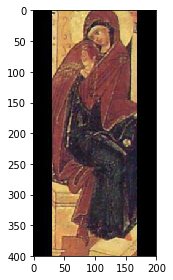

In [174]:
io.imshow(images[13])

(400, 200, 3)

In [8]:
liste =[]
hues = []
for img in tqdm(images):
    hsv = sColor.rgb2hsv(trs.resize(img,(200,100)))
    h = hsv[:,:,0].flatten()
    h = h.reshape((h.shape[0],1))
    hues.append(h)
for h in tqdm(hues):
    grey = list(filter(lambda x: x!=0,h)) == []
    if(not grey):
        kmeans = KMeans(n_clusters=3).fit(h)
        liste.append(kmeans.cluster_centers_)
    else : 
        liste.append(np.asarray([0,0,0]))
    

100%|██████████████████████████████████████| 2787/2787 [03:40<00:00, 12.66it/s]


In [24]:
liste

[array([[ 0.02028807],
        [ 0.92071378]]), array([[ 0.84708942],
        [ 0.02225904]]), array([[ 0.89137227],
        [ 0.02613889]]), array([[ 0.02385886],
        [ 0.87486815]]), array([[ 0.03941473],
        [ 0.75721859]]), array([[ 0.80870679],
        [ 0.0253824 ]]), array([[ 0.00242758],
        [ 0.41313336]]), array([[ 0.02171674],
        [ 0.59989131]]), array([[ 0.57248003],
        [ 0.09999487]]), array([[ 0.04230464],
        [ 0.78813333]]), array([[ 0.04877987],
        [ 0.78338457]]), array([[ 0.64229492],
        [ 0.05573356]]), array([[ 0.04830268],
        [ 0.69767291]]), array([[ 0.84360007],
        [ 0.05502227]]), array([[ 0.85496205],
        [ 0.05412923]]), array([[ 0.09065952],
        [ 0.65710479]]), array([[ 0.04465525],
        [ 0.89086593]]), array([[ 0.04976702],
        [ 0.72851842]]), array([[ 0.02703485],
        [ 0.90648732]]), array([[ 0.070254  ],
        [ 0.63335796]]), array([0, 0, 0]), array([0, 0, 0]), array([[ 0.05958702],
 

In [9]:
r = []
theta = []
acc =0
for img in tqdm(images) :
    hue = liste[acc].flatten()
    theta.append(hue[0]*2*np.pi)
    acc +=1
    hsv = sColor.convert_colorspace(img, 'RGB','HSV')
    r.append(np.mean(np.ndarray.flatten(hsv[:,:,2])))

100%|██████████████████████████████████████| 2787/2787 [01:03<00:00, 43.79it/s]


In [10]:
from matplotlib.offsetbox import AnnotationBbox,OffsetImage

fig = plt.figure(figsize = (170,170))
ax = plt.subplot(111, projection='polar')
ax.scatter(theta, r, marker = '.')
for i in range(len(images)) :
    im = OffsetImage(images[i], cmap = 'gray', zoom=0.75)
    im.image.axis =ax
    ab =AnnotationBbox(im,(theta[i],r[i]),frameon=False) 
    ax.add_artist(ab)
ax.set_rmax(np.max(r))
ax.set_rticks([]) 
ax.grid(True)
plt.show()

In [47]:
fig.savefig("../dominantColor.jpg")

In [18]:
fig = plt.figure(figsize = (170,170))
ax = plt.subplot(111, projection='polar')
ax.scatter(theta, r, marker = '.')
for i in range(len(images)) :
    hsvImg = (theta[i]/(2*np.pi),0.5,0.5)*np.ones((200,200,3))
    rgbImg = sColor.hsv2rgb(hsvImg)
    im = OffsetImage(rgbImg, cmap = 'gray', zoom=0.75)
    im.image.axis =ax
    ab =AnnotationBbox(im,(theta[i],r[i]),frameon=False) 
    ax.add_artist(ab)
ax.set_rmax(np.max(r))
ax.set_rticks([]) 
ax.grid(True)
plt.show()